# ESA PolInSAR & BIOMASS 2023
# 7th Advanced Training Course on Radar Polarimetry
# 12-16 June 2023 - ISAE-SUPAERO, Toulouse, France 
# Part 2: The coherency matrix and the entropy/anisotropy/alpha decomposition

* Acquisition: San Francisco (USA), ALOS PALSAR, L-band

* Path to images: /projects/s3-drive/user-data/polinsar/data/

* SLC (single-look complex) real & imag parts files:
    * HH: i_HH.bin, q_HH.bin
    * HV: i_HV.bin, q_HV.bin
    * VH: i_VH.bin, q_VH.bin
    * VV: i_VV.bin, q_VV.bin
    
* Original Image size (px in azimuth x range): 18432 x 1248


Tips:
- focus on a azimuth block within pixels [7000, 12000].

In [1]:
%matplotlib widget
# import useful libraries, functions, and modules

import matplotlib.pyplot as plt
import numpy as np
from scipy.ndimage import uniform_filter

def HSV_colormap_to_rgb(colormap, h, s, v):
    """
    Makes an HSV-like RGB representation based on the given colormap instead
    of 'hsv' colormap.
    
    See https://en.wikipedia.org/wiki/HSL_and_HSV

    Parameters
    ----------
    colormap : function
        Colormap function. Takes the values in 'h' array and returns an RGBA
        value for each point. The ones in matplotlib.cm should be compatible
    h : ndarray
        Hue values. Usually between 0 and 1.0.
    s : ndarray
        Saturation values. Between 0 and 1.0.
    v : ndarray
        Value values. Between 0 and 1.0.

    Returns
    -------
    rgb: ndarray
        An array with the same shape as input + (3,) representing the RGB.
    """
    # Generate color between given colormap (colormap(h)) and white (ones)
    # according to the given saturation
    tmp = (1-s)[..., np.newaxis]*np.ones(3) + s[..., np.newaxis] * colormap(h)[...,:3]
    # Scale it by value
    return v[..., np.newaxis] * tmp


**Function for multilook operation:**
- inputs: image1, image2, looksa, looksr
- outputs: correlation

In [2]:
def calculate_covariance(im1, im2, looksa, looksr) :
    
    corr = uniform_filter( np.real(im1 * np.conj(im2)), [looksa, looksr] ) + \
            1j * uniform_filter( np.imag(im1 * np.conj(im2)), [looksa, looksr] )
    
    return corr

**Function for eigenvalues and eigenvectors computation:**
- inputs: elements of the covariance matrix T11, T12, T13, T22, T23, T33
- outputs: eigenvalues, eigenvectors

In [3]:
def calculate_eigenvalues_3(T11, T12, T13, T22, T23, T33):

    # Calculate and order (from max to min) the eigenvalues of a 3x3 hermitian matrix in closed-form.
    # Inputs can be 2D az - rg (rows - columns).

    # get dimensions
    dim = T11.shape

    # calculate auxiliary quantities
    A = T11*T22 + T11*T33 + T22*T33 - T12*np.conj(T12) - T13*np.conj(T13) - T23*np.conj(T23)
    B = T11**2 - T11*T22 + T22**2 -T11*T33 -T22*T33 + T33**2 + 3*T12*np.conj(T12) + 3*T13*np.conj(T13) + 3*T23*np.conj(T23)

    DET = T11*T22*T33 - T33*T12*np.conj(T12) - T22*T13*np.conj(T13) - T11*T23*np.conj(T23) + T12*np.conj(T13)*T23 + np.conj(T12)*T13*np.conj(T23)  
    TR = T11 + T22 + T33 
    Z = 27*DET-9*A*TR + 2*TR**3 + np.sqrt((27*DET-9*A*TR + 2*TR**3)**2-4*B**3)
    
    del DET
    
    # ... and here they are:
    LA = ( 1/3.*TR + 2**(1/3.)*B/(3*Z**(1/3.)) + Z**(1/3.)/(3*2**(1/3.)) )
    LB = ( 1/3.*TR - (1+1j*np.sqrt(3))*B/(3*2**(2/3.)*Z**(1/3.)) - (1-1j*np.sqrt(3))*Z**(1/3.)/(6*2**(1/3.)) )
    LC = ( 1/3.*TR - (1-1j*np.sqrt(3))*B/(3*2**(2/3.)*Z**(1/3.)) - (1+1j*np.sqrt(3))*Z**(1/3.)/(6*2**(1/3.)) )
    
    # now order them:
    dumm = np.zeros((dim[0], dim[1], 3), 'float32')
    dumm [:, :, 0] = np.real(LA)
    del LA
    dumm [:, :, 1] = np.real(LB)
    del LB    
    dumm [:, :, 2] = np.real(LC)
    del LC  
    
    L1 = np.max(dumm, axis = 2)
    L3 = np.min(dumm, axis = 2)
    L2 = np.sum(dumm, axis = 2) - L1 - L3
    
    del dumm
    
    return L1, L2, L3
    

In [4]:
def calculate_eigenvectors_3(T11, T12, T13, T22, T23, T33, L1, L2, L3) :

    # Calculate the eigenvectors corresponding to the eigenvalues (L1, L2, L3)
    # of a 3x3 matrix 
    # Inputs can be 2D az - rg (rows - columns).

    # get dimension
    dim = T11.shape    
    
    # now calculate the first eigenvector - corresponds to the maximum eigenvalue L1
    U1 = np.ones((dim[0], dim[1], 3), 'complex64')
    U1[:, :, 0] = (L1 -T33)/np.conj(T13) + (((L1-T33)*np.conj(T12) + np.conj(T13)*T23)*np.conj(T23))/ \
                    (((T22-L1)*np.conj(T13) - np.conj(T12)*np.conj(T23))*np.conj(T13))
    U1[:, :, 1] = -((L1-T33)*np.conj(T12)+np.conj(T13)*T23) / ((T22-L1)*np.conj(T13) - np.conj(T12)*np.conj(T23))
    
    # second eigenvector - corresponds to the eigenvalue L2
    U2 = np.ones((dim[0], dim[1], 3), 'complex64')
    U2[:, :, 0] = (L2 -T33)/np.conj(T13) + (((L2-T33)*np.conj(T12) + np.conj(T13)*T23)*np.conj(T23))/ \
                    (((T22-L2)*np.conj(T13) - np.conj(T12)*np.conj(T23))*np.conj(T13))
    U2[:, :, 1] = -((L2-T33)*np.conj(T12)+np.conj(T13)*T23) / ((T22-L2)*np.conj(T13) - np.conj(T12)*np.conj(T23))
    
    # third eigenvector - corresponds to the minimum eigenvalue L3
    U3 = np.ones((dim[0], dim[1], 3), 'complex64')
    U3[:, :, 0] = (L3 -T33)/np.conj(T13) + (((L3-T33)*np.conj(T12) + np.conj(T13)*T23)*np.conj(T23))/ \
                    (((T22-L3)*np.conj(T13) - np.conj(T12)*np.conj(T23))*np.conj(T13))
    U3[:, :, 1] = -((L3-T33)*np.conj(T12)+np.conj(T13)*T23) / ((T22-L3)*np.conj(T13) - np.conj(T12)*np.conj(T23))   
    
    # and finally normalize to get orthonormal eigenvectors
    norm1 = np.sqrt( np.abs(U1[:,:,0])**2 + np.abs(U1[:,:,1])**2 + np.abs(U1[:,:,2])**2)
    norm2 = np.sqrt( np.abs(U2[:,:,0])**2 + np.abs(U2[:,:,1])**2 + np.abs(U2[:,:,2])**2)    
    norm3 = np.sqrt( np.abs(U3[:,:,0])**2 + np.abs(U3[:,:,1])**2 + np.abs(U3[:,:,2])**2)        
    for nn in range(3):
        U1[:,:,nn] = U1[:,:,nn] / norm1
        U2[:,:,nn] = U2[:,:,nn] / norm2
        U3[:,:,nn] = U3[:,:,nn] / norm3
        
    del norm1
    del norm2
    del norm3     
    
    return U1, U2, U3


## Exercise 4: Target decomposition theomems. Eigenvalue/Eigenvector decomposition and  H/A/Alpha parameters

In this exersise you are going to compute the Eigenvalue/Eigenvectir decomposition and the associated H/A/Alpha parameters. This decomposition allows to characerize and to interpret the scattering mechanism present in the scene.

**Step 1: Load data**. In this step you have to load the data and select a section of the whole image compris ingthe azimuth between sampels 7000 to 12000.

In [5]:
# path to data
path = '/home/anton/Desktop/Polarimetry training 2023 Resources/Tuesday - PolSAR/2023_Polarimetry_PolSAR_CLopez-Martinez_LFerro-Famil_Practical/data/'


img_shape = (18432, 1248)

def read_slc(pol_name):
    slc = np.fromfile(path + 'i_%s.bin' % pol_name, dtype=np.float32) + 1j*np.fromfile(path + 'q_%s.bin' % pol_name, dtype=np.float32)
    return slc.reshape(img_shape) / 1e6

slchh = read_slc('HH')
slchv = read_slc('HV')
slcvh = read_slc('VH')
slcvv = read_slc('VV')
 
slchh.shape

(18432, 1248)

In [6]:
# Crop images in azimuth
crop_az = (7000, 12000)
slchh = slchh[crop_az[0]:crop_az[1], :]
slchv = slchv[crop_az[0]:crop_az[1], :]
slcvh = slcvh[crop_az[0]:crop_az[1], :]
slcvv = slcvv[crop_az[0]:crop_az[1], :]

slchh.shape

(5000, 1248)

**Step 2 : Calculate the necessary elements of the coherency matrix**. In this step you have to copute the coherency matrix of the image, taking into accout that this matrix is derived through a speckle filtering process. Consider a standard Boxcar filter, where the filter dimension can not be equal to obtain a filtered image with a better aspect ratio.

In [7]:
looksa = 9
looksr = 5

# --- calculate Pauli elements
pauli1 = (slchh + slcvv) / np.sqrt(2)
pauli2 = (slchh - slcvv) / np.sqrt(2)
pauli3 = (slchv + slcvh) / np.sqrt(2)

# --- calculate elements of the coherency matrix
T11 = calculate_covariance(pauli1, pauli1, looksa, looksr)
T22 = calculate_covariance(pauli2, pauli2, looksa, looksr)
T33 = calculate_covariance(pauli3, pauli3, looksa, looksr)
T12 = calculate_covariance(pauli1, pauli2, looksa, looksr)
T13 = calculate_covariance(pauli1, pauli3, looksa, looksr)
T23 = calculate_covariance(pauli2, pauli3, looksa, looksr)

In [8]:
wp = np.dstack((pauli1, pauli2, pauli3))
T3 = np.einsum('...i,...j->...ij', wp, wp.conj())

In [9]:
# Delete original SLCs to save memory
del slchh, slcvv, slchv, slcvh

**Step 3 : Calculate eigenvalues**. In this step you must derive the eigenvalues (3) associated to the eigenvalue/eigenvector decomposition of the coherency matrix.

In [10]:
lambda1, lambda2, lambda3 = calculate_eigenvalues_3(T11, T12, T13, T22, T23, T33)

In [11]:
lambda1.shape

(5000, 1248)

**Step 4 : Calculate entropy**: In this step you must obtain the Entopy parameter (H) derived from the eigenvalues. Remember that the Entropy is derived from the associated probabilities of the eigenvalues and not form the eigenvalues directly.

In [12]:
# --- Compute probabilities

pr1 = lambda1 / (lambda1 + lambda2 + lambda3) 
pr2 = lambda2 / (lambda1 + lambda2 + lambda3)
pr3 = lambda3 / (lambda1 + lambda2 + lambda3)

# --- Compute entropy
entropy = - ( pr1*np.log10(pr1)/np.log10(3) + pr2*np.log10(pr2)/np.log10(3) + pr3*np.log10(pr3)/np.log10(3) )


**Step 5 : Calculate Anisotropy**. In this step you must obtain the Anosotropy parameter (A) derived from the eigenvalues. 

In [13]:
anisotropy = (lambda2 - lambda3) / (lambda2 + lambda3)

**Step 6 : Calculate eigenvectors**. In this step you must derive the eigenvectors (3) associated to the eigenvalue/eigenvector decomposition of the coherency matrix.

In [14]:
U1, U2, U3 = calculate_eigenvectors_3(T11, T12, T13, T22, T23, T33, lambda1, lambda2, lambda3)

In [15]:
U1.shape
del lambda1, lambda2, lambda3

**Step 7: Calculate mean Alpha angle**: In this step you must obtain the mean Alpha Angle parameter (Alpha) derived from the eigenvectors of the cogherency matrix. 

In [16]:
# extract alpha angles

alpha1 = np.arccos(np.abs(U1[:,:,0]))
del U1
alpha2 = np.arccos(np.abs(U2[:,:,0]))
del U2
alpha3 = np.arccos(np.abs(U3[:,:,0]))
del U3


In [17]:
# calculate the mean alpha angle
alpha = pr1*alpha1 + pr2*alpha2 + pr3*alpha3 # [rad]
alpha = alpha * 180/np.pi   # [deg]


**Step 8: Plot**: In this step you must plot the different results. To better interpret the eigendecomposition of the coherency matrix, as well as the different parameter derived from it, it is proposed to compute and plot firs the Pauli decomposiion. Them plot the probalilities, the paramenters H/A/Alpha and a HSV composition of H/Alpha.

In [18]:
# -- Generate Pauli RGB from coherency matrix diagonal elements
# NOTE: square root applied to convert intensities to amplitudes for visualization
# NOTE: the ordering of channels R, G, B --> Pauli 2, Pauli 3, Pauli 1
naz = pauli1.shape[0]
nrg = pauli1.shape[1]
pauli_rgb = np.zeros((nrg, naz, 3), 'float32')

pauli_rgb[:,:,0] = np.clip(np.transpose(np.sqrt(np.abs(T22))), 0, 2.5*np.mean(np.sqrt(np.abs(T22)))) 
pauli_rgb[:,:,1] = np.clip(np.transpose(np.sqrt(np.abs(T33))), 0, 2.5*np.mean(np.sqrt(np.abs(T33)))) 
pauli_rgb[:,:,2] = np.clip(np.transpose(np.sqrt(np.abs(T11))), 0, 2.5*np.mean(np.sqrt(np.abs(T11)))) 

pauli_rgb[:,:,0] = pauli_rgb[:,:,0] / np.max(pauli_rgb[:,:,0]) 
pauli_rgb[:,:,1] = pauli_rgb[:,:,1] / np.max(pauli_rgb[:,:,1]) 
pauli_rgb[:,:,2] = pauli_rgb[:,:,2] / np.max(pauli_rgb[:,:,2]) 



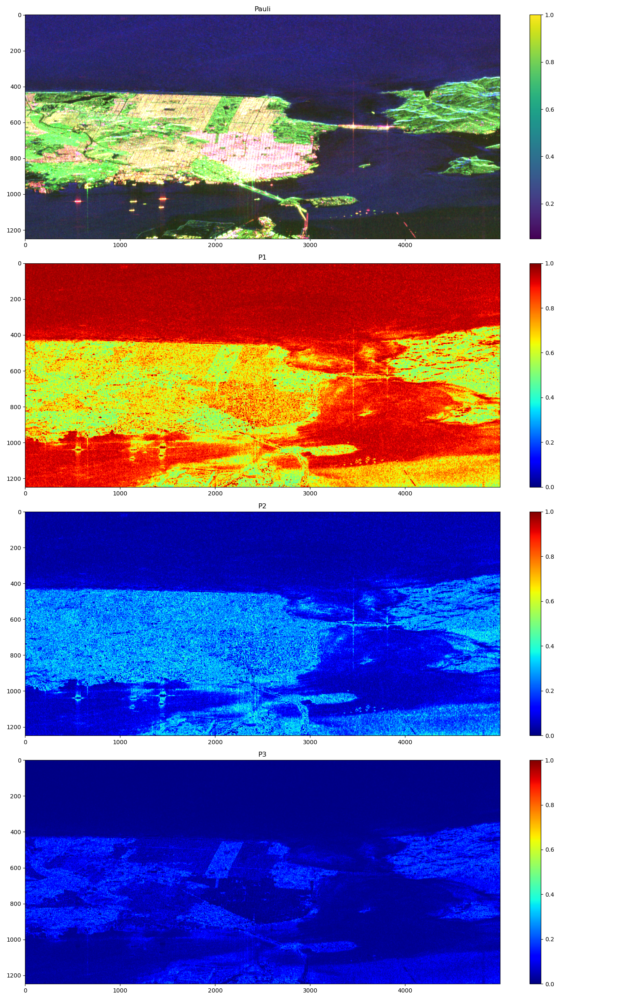

In [19]:
# -- plot Pauli RGB and probabilities

plt.figure(figsize = (15, 6*4))

ax = plt.subplot(4,1,1)
plt.imshow(pauli_rgb, aspect = 'auto')
plt.colorbar() # dummy colorbar to align images
ax.set_title("Pauli")

ax = plt.subplot(4,1,2)
plt.imshow(np.transpose(pr1) , vmin = 0 , vmax = 1, cmap = 'jet', aspect = 'auto', interpolation = 'nearest')
plt.colorbar()
ax.set_title("P1")

ax = plt.subplot(4,1,3)
plt.imshow(np.transpose(pr2) , vmin = 0 , vmax = 1, cmap = 'jet', aspect = 'auto', interpolation = 'nearest')
plt.colorbar()
ax.set_title("P2")

ax = plt.subplot(4,1,4)
plt.imshow(np.transpose(pr3) , vmin = 0 , vmax = 1, cmap = 'jet', aspect = 'auto', interpolation = 'nearest')
plt.colorbar()
ax.set_title("P3")

plt.tight_layout()


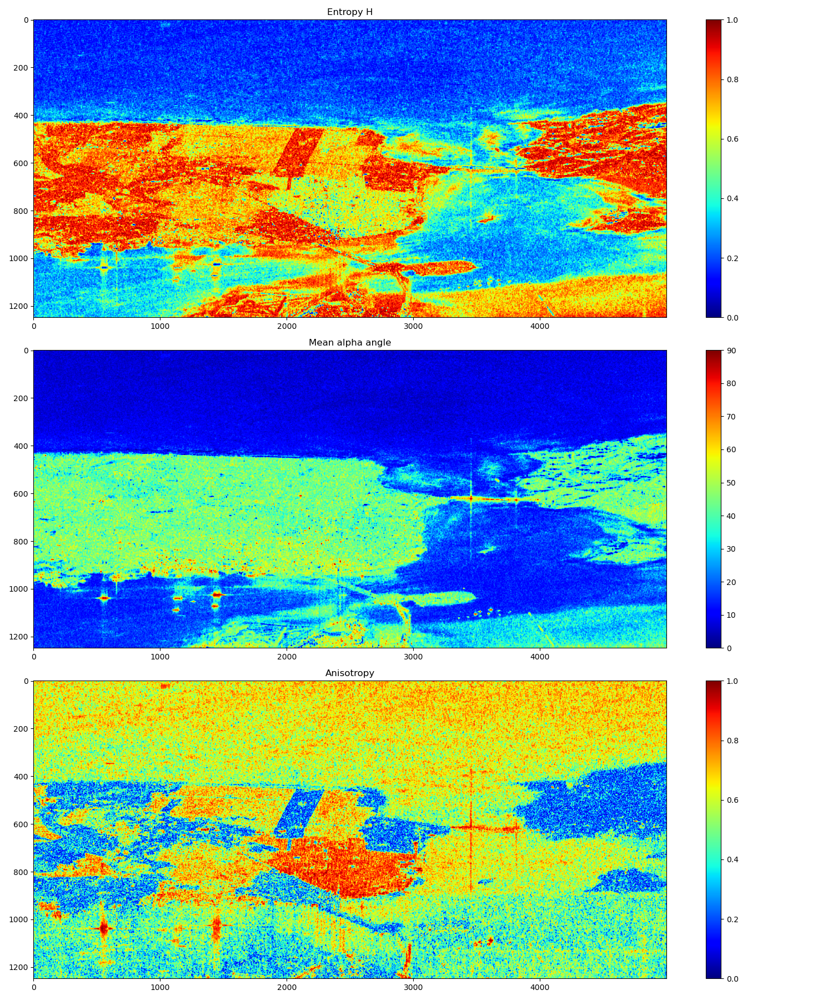

In [20]:
# Plot of entropy / mean alpha / anistropy

plt.figure(figsize = (15, 6*3))
ax = plt.subplot(3,1,1)
plt.imshow(np.transpose(entropy), vmin = 0, vmax = 1, cmap = 'jet', aspect = 'auto', interpolation = 'nearest')
plt.colorbar()
ax.set_title('Entropy H')

ax = plt.subplot(3,1,2)
plt.imshow(np.transpose(alpha), vmin = 0, vmax = 90, cmap = 'jet', aspect = 'auto', interpolation = 'nearest')
plt.colorbar()
ax.set_title('Mean alpha angle')

ax = plt.subplot(3,1,3)
plt.imshow(np.transpose(anisotropy), vmin = 0, vmax = 1, cmap = 'jet', aspect = 'auto', interpolation = 'nearest')
plt.colorbar()
ax.set_title('Anisotropy')

plt.tight_layout()

In [21]:
### HSV representation of H/alpha

colormap = plt.colormaps.get('jet')

# Normalize the alpha into 0 to 1
alpha = alpha / 90

# Intensity : amp
amp = np.sqrt(np.abs(T11) + np.abs(T22) + np.abs(T33))
amp = np.clip(amp, 0, 2.5*np.mean(amp))
amp = amp /np.max(amp)

# First case: take saturation = 1
saturation = np.ones_like(alpha)
rgb_alpha = HSV_colormap_to_rgb(colormap, alpha, saturation, amp)

# Second case: take saturation = 1 - entropy 
saturation = 1 - entropy
rgb_Halpha = HSV_colormap_to_rgb(colormap, alpha, saturation, amp)

In [22]:
del amp, saturation

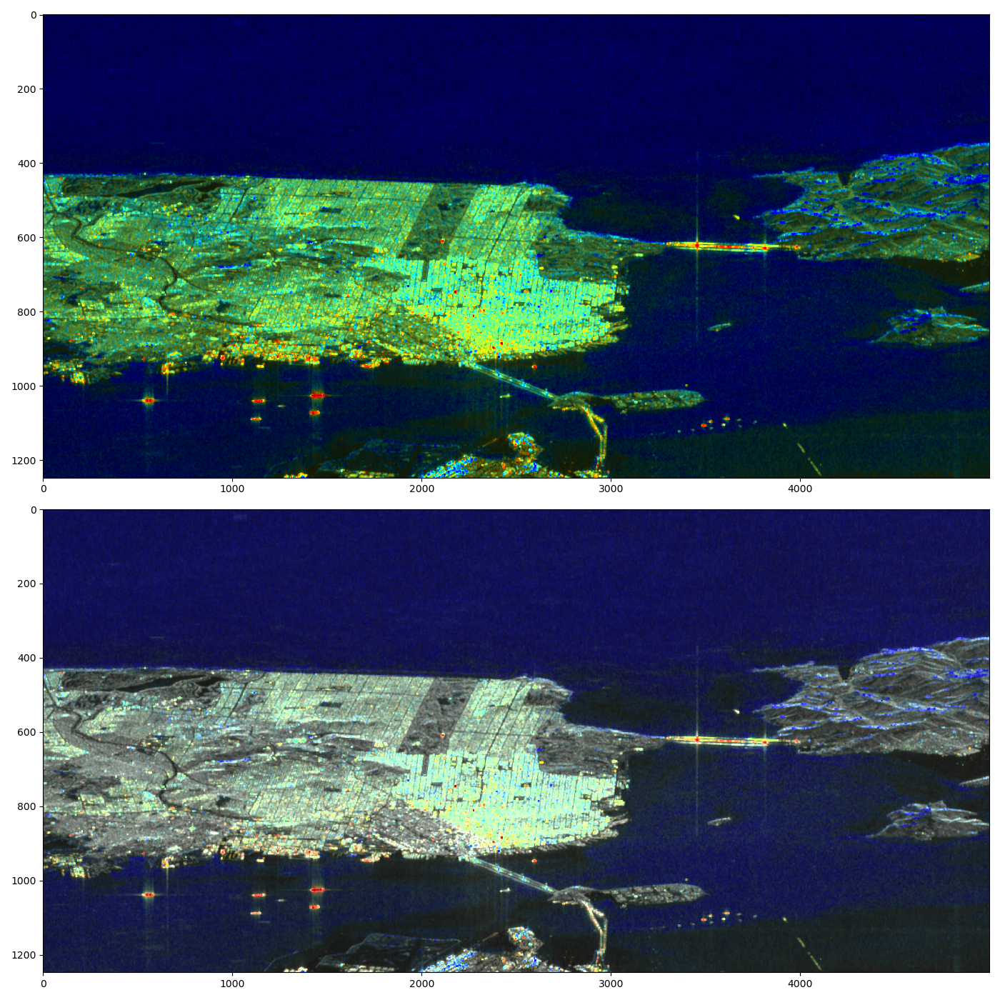

In [23]:
# Plots

plt.figure(figsize = (14, 14))
plt.subplot(2,1,1)
plt.imshow(np.transpose(rgb_alpha, axes = (1,0,2)), aspect = 'auto', interpolation = 'nearest')
plt.subplot(2,1,2)
plt.imshow(np.transpose(rgb_Halpha, axes = (1,0,2)), aspect = 'auto', interpolation = 'nearest')
plt.tight_layout()

